In [1]:
from pathlib import Path

import numpy as np
from PIL import Image

In [2]:
IMAGES = Path('images')

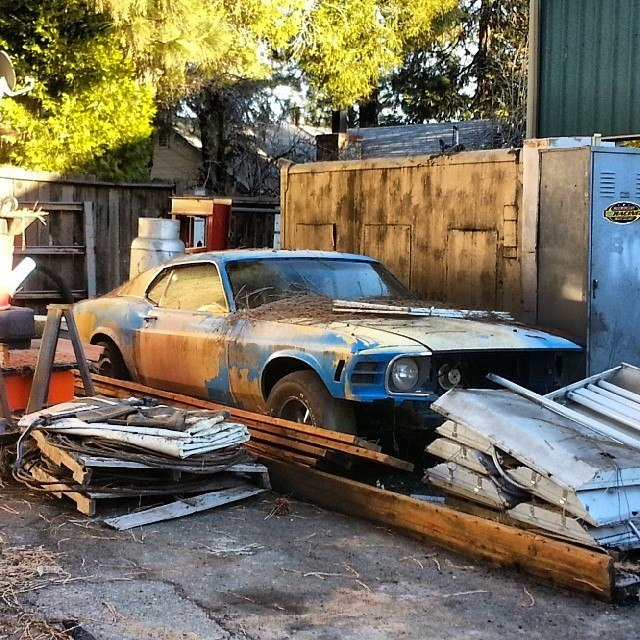

In [3]:
image = Image.open(IMAGES / 'n.jpg')
image.show()

# TASK_A

In [75]:
from PIL import ImageOps

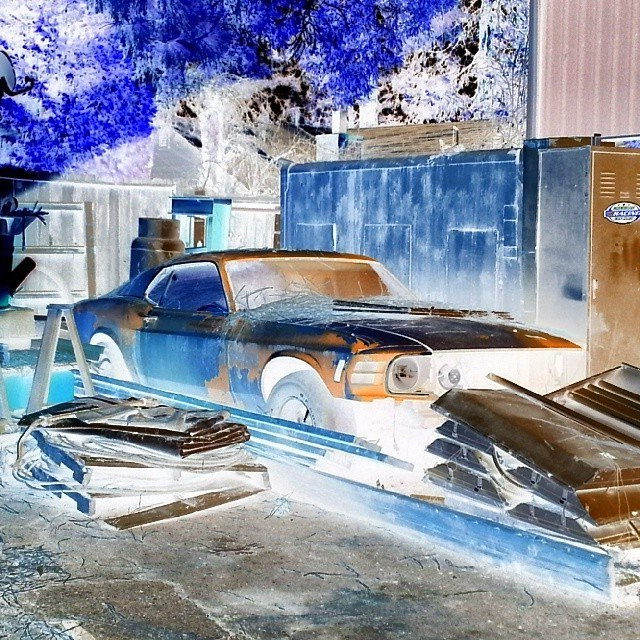

In [76]:
ImageOps.invert(image).show()

# TASK_B

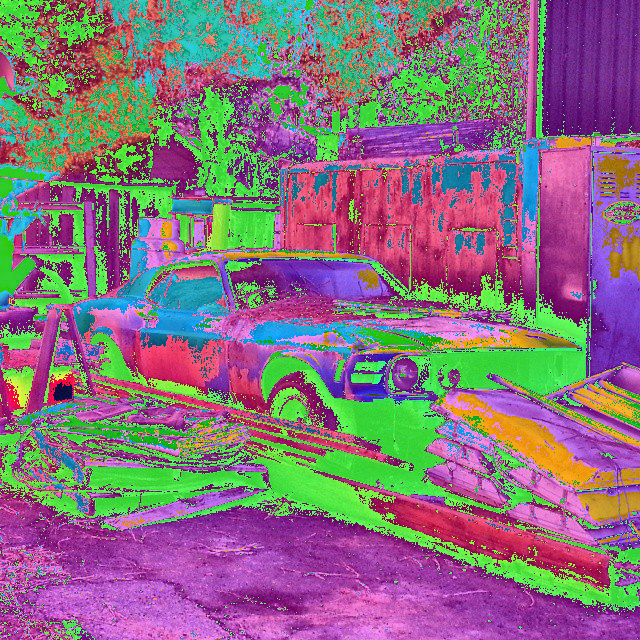

In [32]:
image_copy = np.copy(image)

image_copy[:, :, 0] += 50   # increase red channel by 50
image_copy[:, :, 1] -= 50   # decrease green channel by 50
image_copy[:, :, 2] += 50   # increase blue channel by 50

Image.fromarray(image_copy).show()

# TASK_C

In [47]:
def print_image_with_only_one_channel(image_: Image, channel: int) -> None:
    image_copy = np.copy(image_)
    
    drop_channels = list(set(range(3)) - {channel})
    
    image_copy[:, :, drop_channels] = 0
    Image.fromarray(image_copy).show()

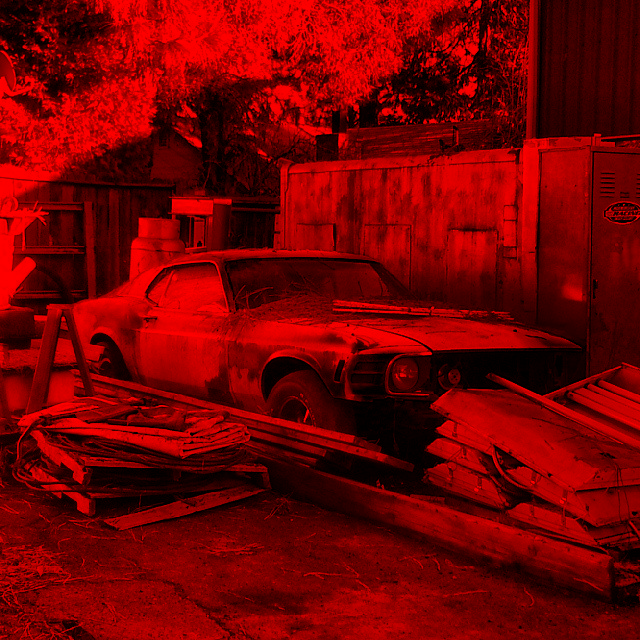

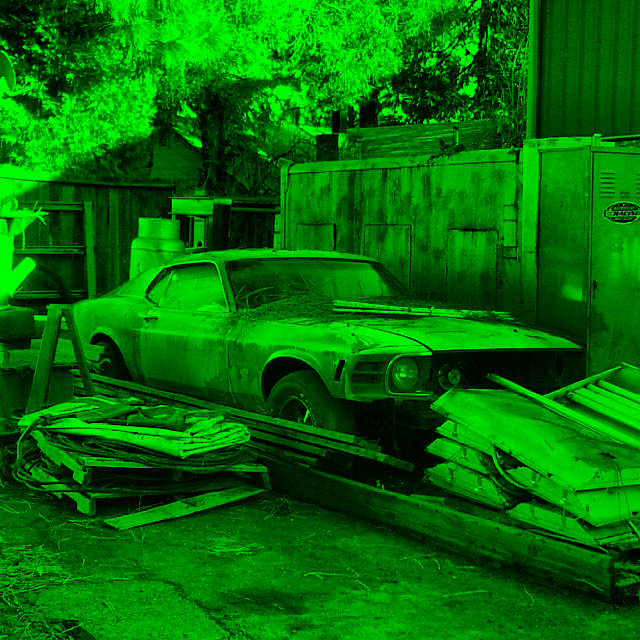

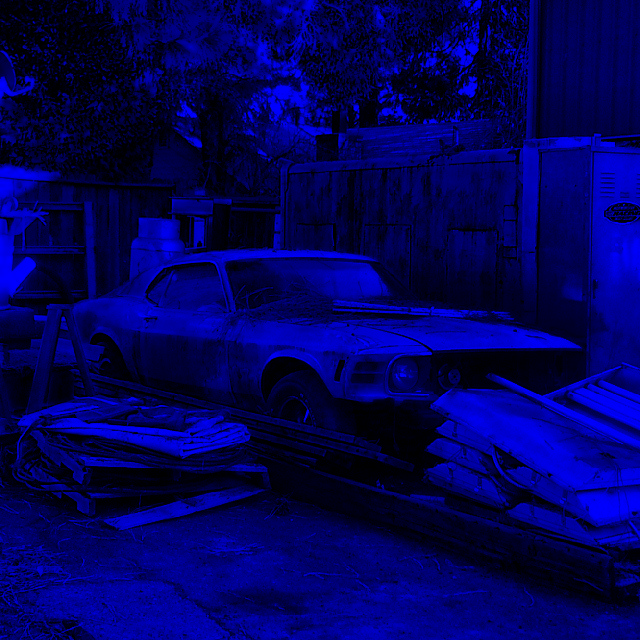

In [51]:
for i in range(3):
    print_image_with_only_one_channel(image, i)

# TASK_D

In [55]:
def print_blended_image(im1: Image, im2: Image, alpha: float = 0.5) -> None:
    assert im1.size == im2.size
    
    Image.blend(im1, im2, alpha).show()

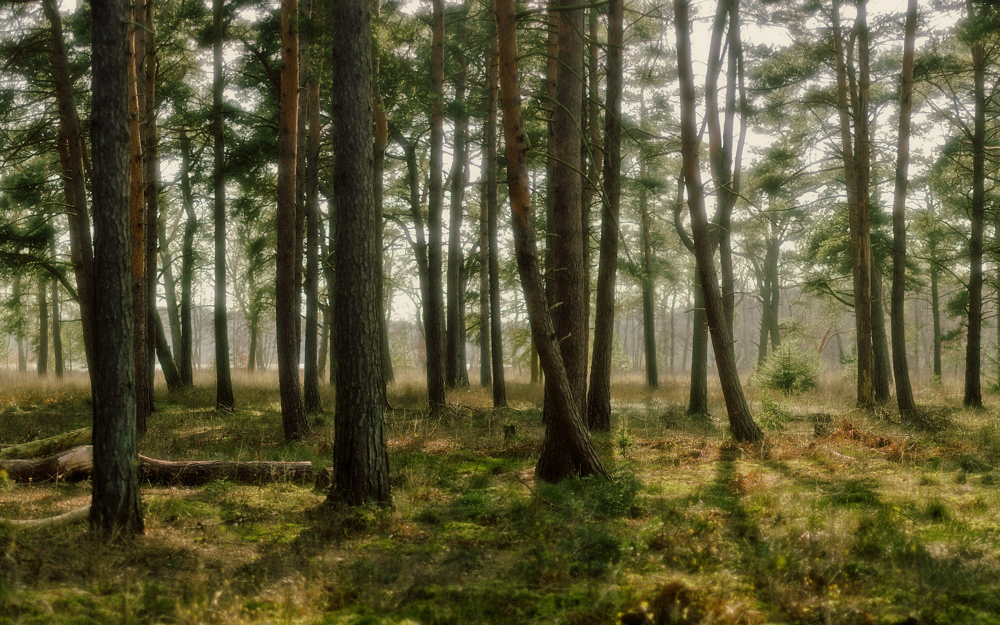

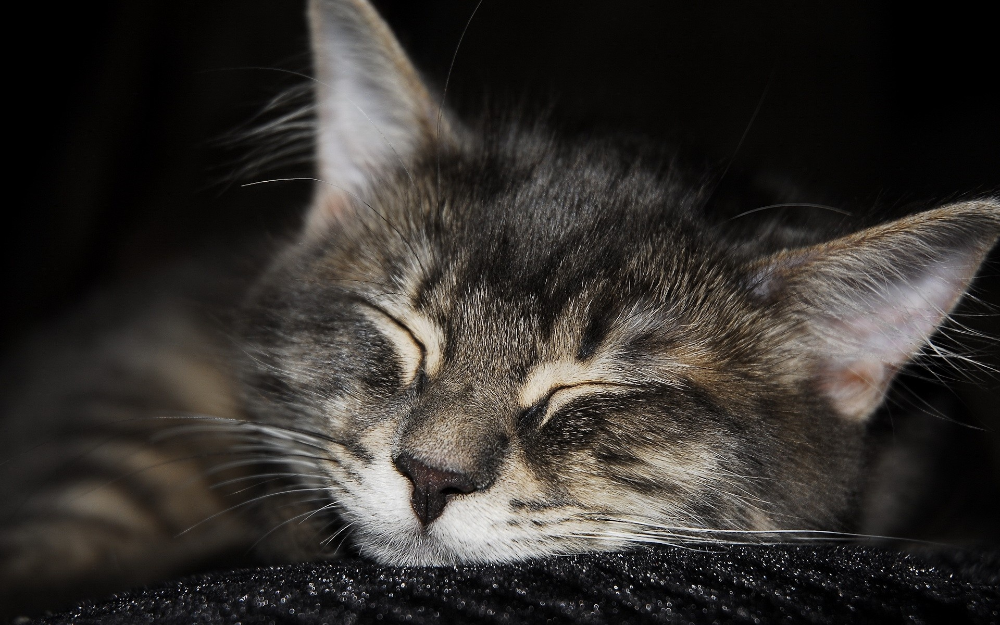

In [52]:
image_1 = Image.open(IMAGES / '1.jpg')
image_2 = Image.open(IMAGES / '2.jpg')

image_1.show()
image_2.show()

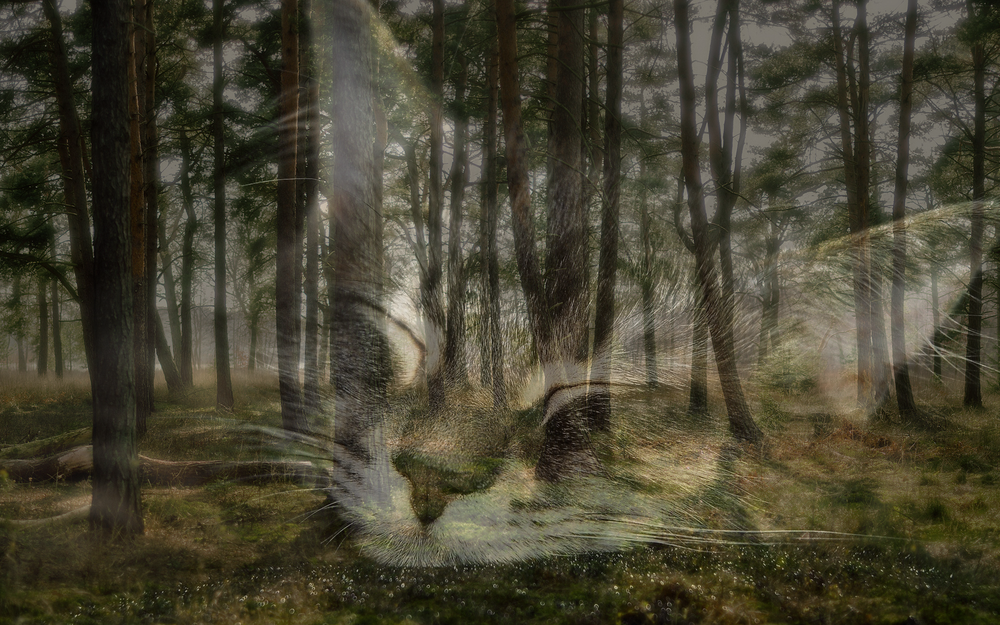

In [59]:
print_blended_image(image_1, image_2, 0.5)

# TASK_E

In [88]:
from PIL import ImageFilter
from scipy.signal import convolve2d

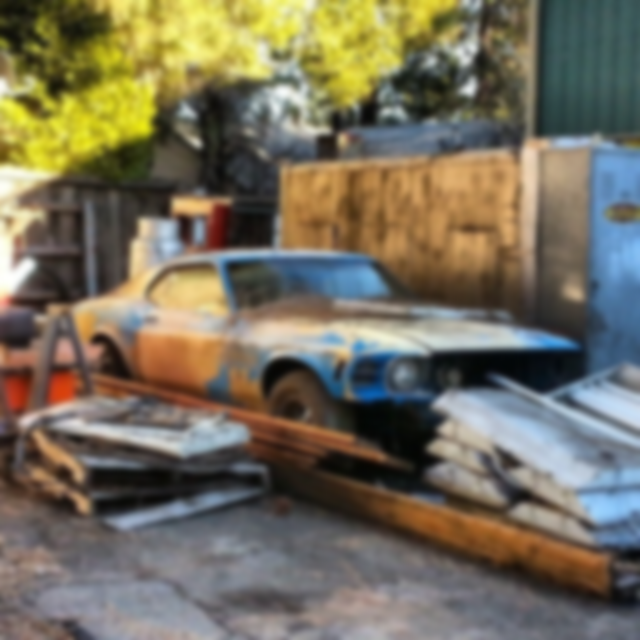

In [86]:
# blur
image.filter(ImageFilter.GaussianBlur(radius=3)).show()

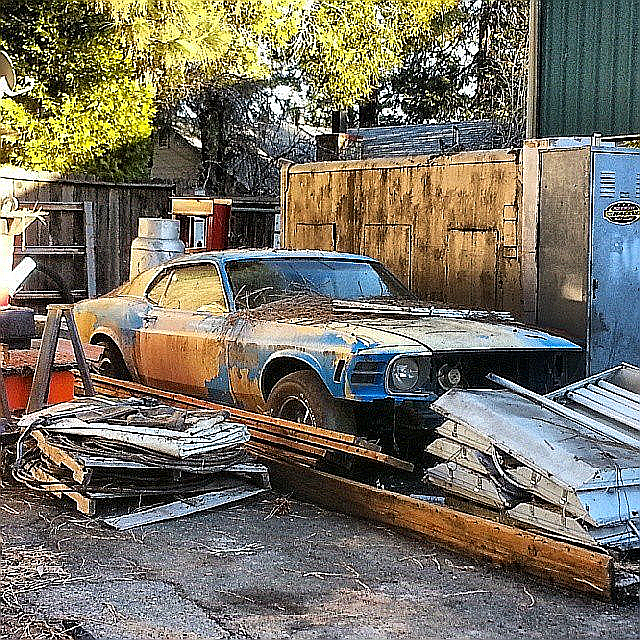

In [69]:
# quality enhance
image.filter(ImageFilter.EDGE_ENHANCE).show()

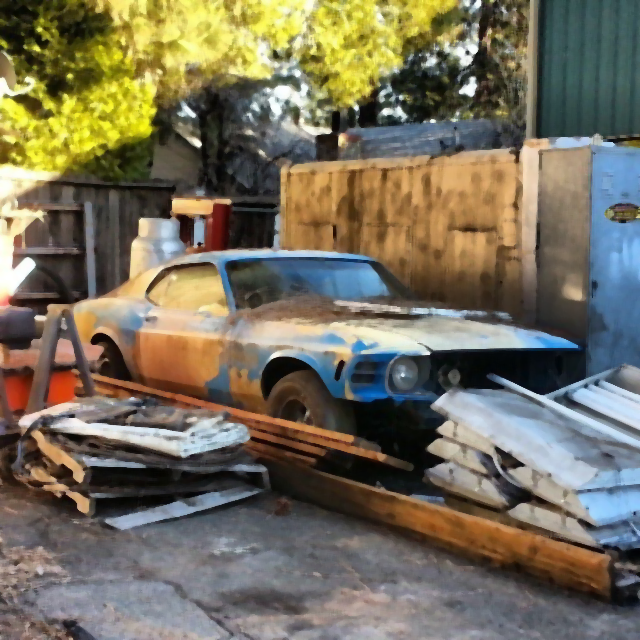

In [74]:
# median
image.filter(ImageFilter.MedianFilter(size=5)).show()

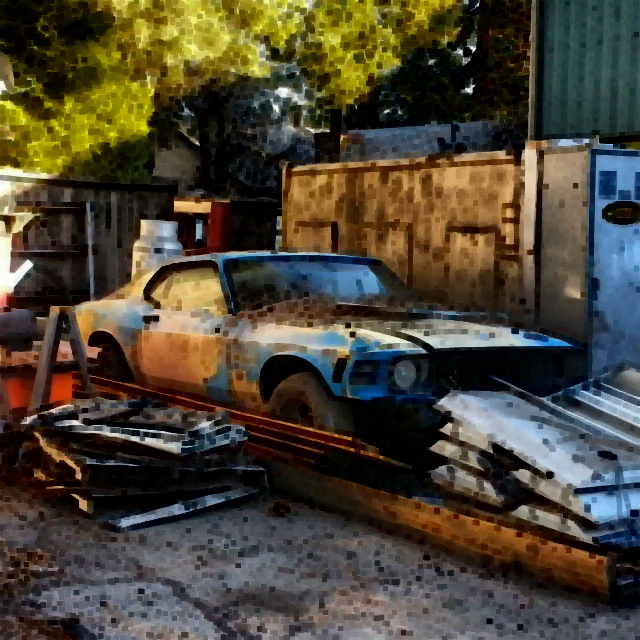

In [83]:
# erosion
image.filter(ImageFilter.MinFilter(size=5)).show()

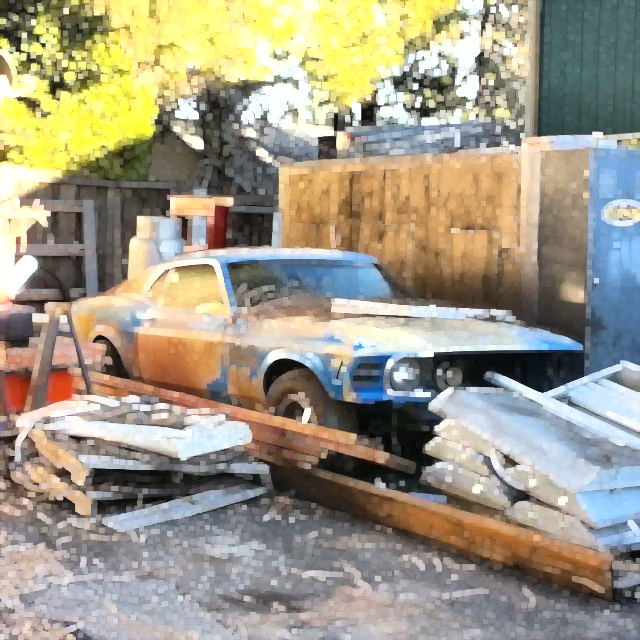

In [85]:
# build-up
image.filter(ImageFilter.MaxFilter(size=5)).show()

In [109]:
def sobel_filter(image: Image) -> Image:
    # Convert the image to grayscale
    gray = image.convert("L")

    array = np.array(gray, dtype=np.float32)

    # Sobel kernels
    G_x = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]])
    G_y = np.array([[-1, -2, -1], [0, 0, 0], [1, 2, 1]])

    # Apply the Sobel kernels to the image
    filtered_x = convolve2d(array, G_x, mode="same")
    filtered_y = convolve2d(array, G_y, mode="same")

    # the magnitude of the Sobel filter
    G = np.sqrt(filtered_x ** 2 + filtered_y ** 2)

    # Scale the magnitude to fit into the [0, 255] range
    G = (G / G.max()) * 255

    # Convert the magnitude to an image
    sobel_image = Image.fromarray(G.astype(np.uint8))

    return sobel_image

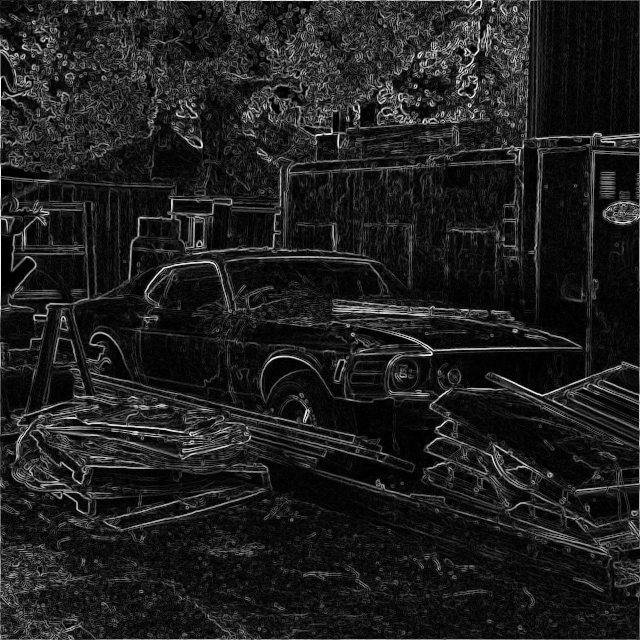

In [110]:
sobel_filter(image).show()

# TASK_F

(269, 300, 3)


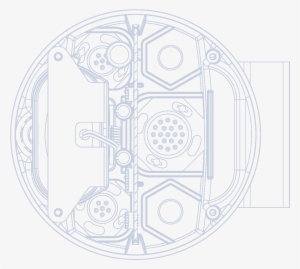

In [4]:
watermark = Image.open(IMAGES / 'watermark-circle.jpeg')
print(np.array(watermark).shape)
watermark

In [63]:
def print_embedded_image_with_watermark(image_: Image, watermark_: Image, bit_plane_number: int = 6) -> None:
    img_array = np.array(image_.convert('L'))

    input_size = image_.size
    watermark_size = watermark_.size

    assert bit_plane_number in range(8)

    if input_size[0] >= watermark_size[0] and input_size[1] >= watermark_size[1]:
        for y in range(0, input_size[1], watermark_size[1]):
            for x in range(0, input_size[0], watermark_size[0]):
                left, upper = 0, 0
                right = min(x + watermark_size[0], input_size[0])
                lower = min(y + watermark_size[1], input_size[1])
                # print(right, lower)
                
                watermark_region = watermark_.crop((left, upper, right - x, lower - y)).convert('L')
                watermark_region_size = watermark_region.size
                # print('size: ', watermark_region_size, '\n')

                watermark_bits_2d = np.unpackbits(np.array(watermark_region)) \
                                    .reshape(watermark_region_size[1], 
                                             watermark_region_size[0], 
                                             8)[:, :, bit_plane_number]
                img_array[
                    y:lower, x:right
                ] = np.bitwise_xor(img_array[y:lower, x:right], watermark_bits_2d << bit_plane_number)
        
        Image.fromarray(img_array).show()

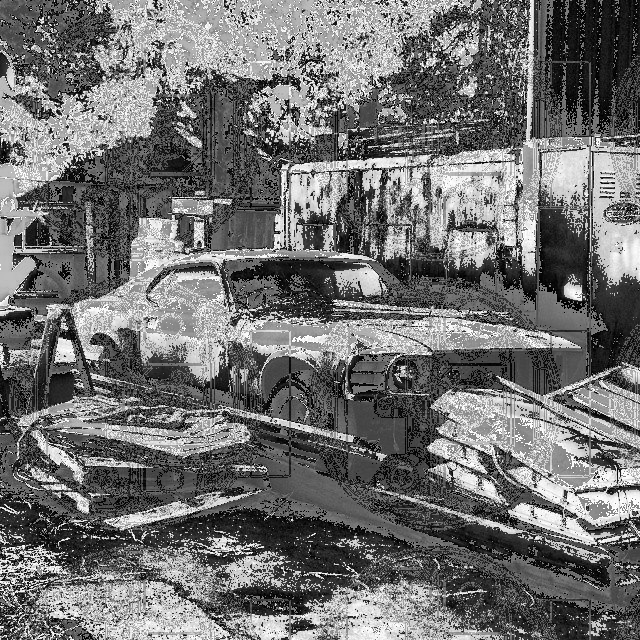

In [65]:
print_embedded_image_with_watermark(image, watermark, 6)